# Springboard notebook for ADC analysis

In [1]:
# Basic plotting setup for the notebook
import matplotlib.pyplot as plt
from matplotlib import colormaps, colors

%matplotlib inline
plt.rcParams["image.cmap"] = "inferno"
plt.rcParams["font.family"] = "serif"
plt.rcParams["image.origin"] = "lower"
plt.rcParams["figure.dpi"] = 120

inferno = colormaps["inferno"]
seismic = colormaps["seismic"]

inferno.set_bad("k", 0.5)
seismic.set_bad("k", 0.5)

# Jax imports
import jax.numpy as np
import jax.numpy as np

## Process the uncal data 

This cell is just so you can access the _fully raw_ data if you want, and to show how the data is processed. You can skip it if you have the processed data already as this notebook is set up to load the processed file in the next cells.

In [2]:
import os
import numpy as onp
from astropy.stats import sigma_clip
from astropy.io import fits

def calc_mean_and_std_err(data, axis=0):
    support = np.asarray(~np.isnan(data), int).sum(axis)
    mean = np.nanmean(data, axis=axis)
    std_err = np.sqrt(np.nanvar(data, axis=axis) / support)
    return mean, std_err

def apply_sigma_clip(array, sigma=5.0, axis=0):
    masked = onp.ma.masked_invalid(array, copy=True)
    clipped = sigma_clip(masked, axis=axis, sigma=sigma)
    return onp.ma.filled(clipped, fill_value=-1)

def process(data, sigma=5.0):
    data = np.array(apply_sigma_clip(data, sigma))
    data = np.where(data == -1, np.nan, data)
    mean, std_err = calc_mean_and_std_err(data)
    return mean, std_err

### Uncomment below if you want to process the uncal data yourself

In [3]:
uncal_path = "/Users/louis/Data/JWST/amigo_data/CAL04481/uncal_data/"
save_path = "files/ADC_exploration/"

for fname in os.listdir(uncal_path):
    # Get the file
    if not fname.endswith(".fits"):
        continue
    file = fits.open(uncal_path + fname)

    # Process the data
    data = np.array(file[1].data, int)
    ramp, ramp_err = process(data)
    slopes, slope_err = process(np.diff(data, axis=1))

    # Save the data
    filt, dither = file[0].header["FILTER"], file[0].header["EXPOSURE"]
    np.save(save_path + f"{filt}_{dither}_ramp.npy", ramp)
    np.save(save_path + f"{filt}_{dither}_ramp_err.npy", ramp_err)
    np.save(save_path + f"{filt}_{dither}_slope.npy", slopes)
    np.save(save_path + f"{filt}_{dither}_slope_err.npy", slope_err)

    # Close the file
    file.close()

## Load the processed data and the model slopes

In [4]:
import os
import jax.numpy as np
import jax.tree_util as jtu

# Need to re-apply the badpix mask since nans get saved as zeros in (jax only?) npy files
badpix = np.load("../amigo/data/badpix.npy").at[42, 1].set(True)

# Functions to load the data and nan the bad pixels
data_path = "files/ADC_exploration/"
key_fn = lambda fname: "_".join(fname.split("_")[:2])
load_fn = lambda fname: np.load(data_path + fname).at[:, *np.where(badpix)].set(np.nan)

# Load the data into dictionary
files = os.listdir(data_path)
ramps = dict([(key_fn(f), load_fn(f)) for f in files if "ramp.npy" in f])
ramp_errs = dict([(key_fn(f), load_fn(f)) for f in files if "ramp_err.npy" in f])
model_slopes = dict([(key_fn(f), load_fn(f)) for f in files if "model_slopes.npy" in f])

## Convert model slopes to ramp and add the pedestals from the data

In [5]:
def slope_to_ramp(slopes, ramp):
    zpoint = ramp[:1]
    return np.concatenate([zpoint, zpoint + np.cumsum(slopes, 0)])

model_ramps = jtu.tree_map(slope_to_ramp, model_slopes, ramps)

## Examine the final read of the data

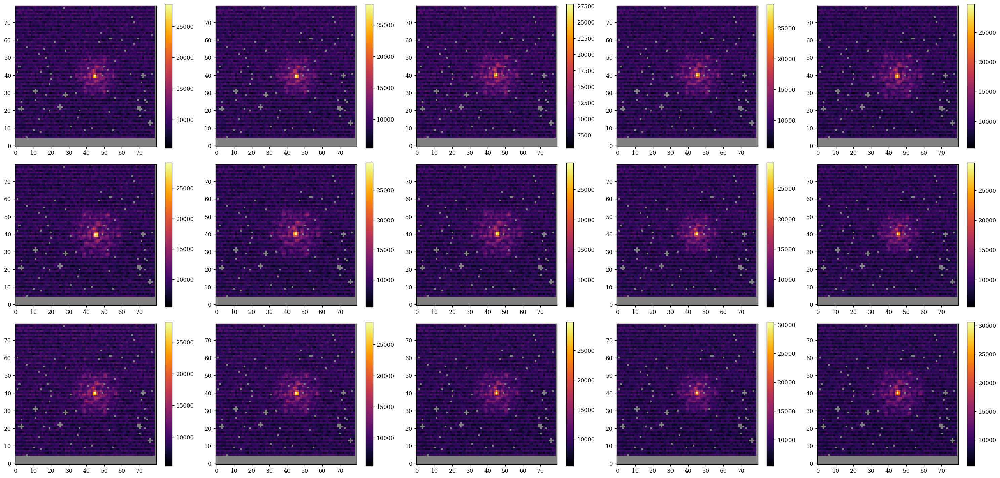

In [6]:
min_counts = 100
plt.figure(figsize=(25, 12))
for i, ramp in enumerate(ramps.values()):
    plt.subplot(3, 5, i + 1)
    plt.imshow(ramp[-1], inferno)
    plt.colorbar()
plt.tight_layout()
plt.show()

## Check the model and data residuals

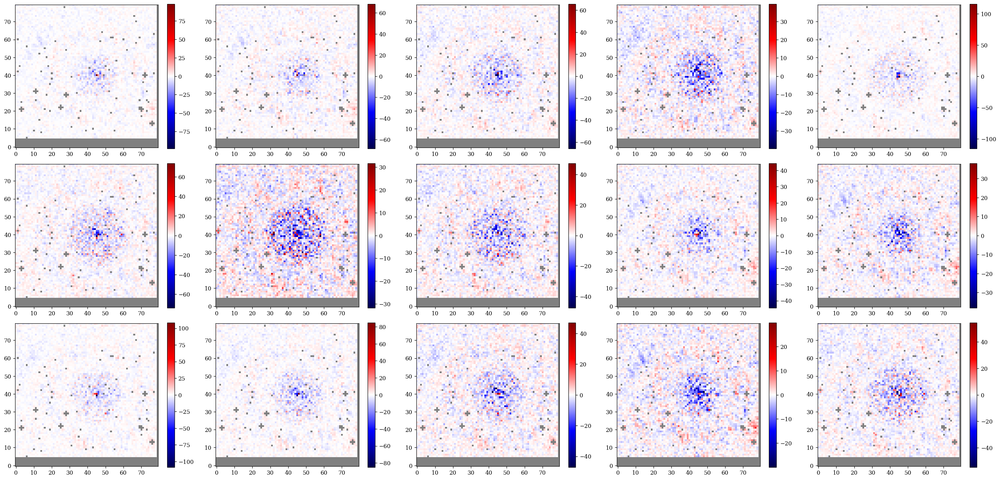

In [7]:
min_counts = 100
plt.figure(figsize=(25, 12))
for i, key in enumerate(ramps.keys()):
    res = ramps[key][-1] - model_ramps[key][-1]
    v = np.nanmax(np.abs(res))

    plt.subplot(3, 5, i + 1)
    plt.imshow(res, seismic, vmin=-v, vmax=v)
    plt.colorbar()
plt.tight_layout()
plt.show()

## Look at the pixels that are included in the analysis

Note: If we generate the mask using a threshold on the _data_, the pixels selected are very different because the bias (ie the pedestal) is very large. This also seems to reduce the frequency signal we see, which i think means we only see this effect for pixels that read over a large range over the ramp.

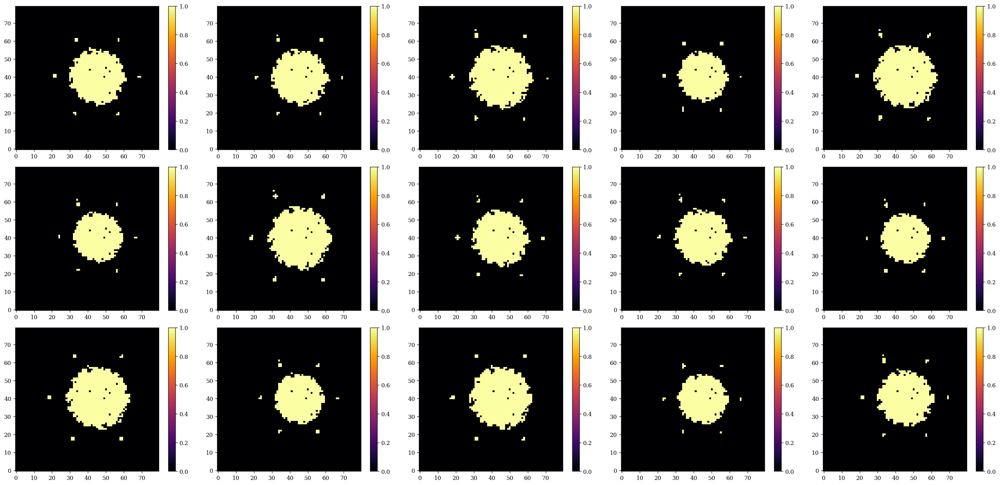

In [8]:
min_counts = 200
plt.figure(figsize=(25, 12))
for i, slope in enumerate(model_slopes.values()):
    total_counts = np.sum(slope, axis=0)
    mask = total_counts > min_counts
    plt.subplot(3, 5, i + 1)
    plt.imshow(mask)
    plt.colorbar()
plt.tight_layout()
plt.show()

## Get the pixels with real signal and the residuals

In [9]:
# Get the indices of the pixels that are above the threshold
ind_fn = lambda slopes: np.where(slopes.sum(0) > min_counts)
mask_inds = jtu.tree_map(ind_fn, model_slopes)

# Get the (flattened) masked model, data, error and residual values
mask_fn = lambda x, inds: x[:, *inds].flatten()
model_values = jtu.tree_map(mask_fn, model_ramps, mask_inds)
data_values = jtu.tree_map(mask_fn, ramps, mask_inds)
data_err_values = jtu.tree_map(mask_fn, ramp_errs, mask_inds)
residuals = jtu.tree_map(lambda a, b: a - b, model_values, data_values)

# Convert the dictionaries to vectors
dict_to_vec = lambda leaf: np.concatenate(jtu.tree_leaves(leaf))
predicted_inputs = dict_to_vec(model_values)
measured_outputs = dict_to_vec(data_values)
output_errs = dict_to_vec(data_err_values)
residuals = dict_to_vec(residuals)

## Plot the raw residual data

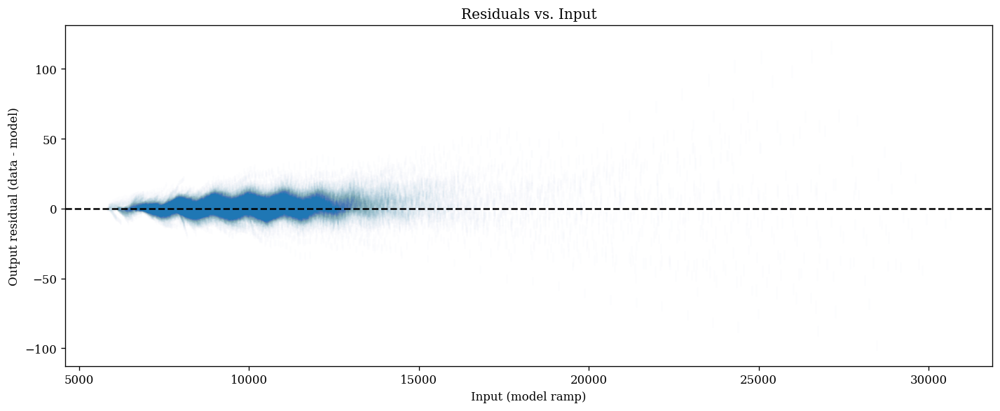

In [10]:
plt.figure(figsize=(12, 5))
plt.errorbar(
    predicted_inputs,
    residuals,
    yerr=output_errs,
    marker="None",
    linestyle="None",
    alpha=0.01,
)
plt.axhline(0, color="k", linestyle="--")
plt.title("Residuals vs. Input")
plt.xlabel("Input (model ramp)")
plt.ylabel("Output residual (data - model)")

plt.tight_layout()
plt.show()

## Bins the data and do some stats on the bins

In [11]:
# Get the bin indices
bin_size = 100
bin_edges = np.arange(predicted_inputs.min(), predicted_inputs.max(), bin_size)
bin_indices = np.digitize(predicted_inputs, bin_edges) - 1
bin_inds = [np.where(bin_indices == i) for i in range(len(bin_edges) - 1)]

# Get the fn to nan the bins with small values
bin_thresh = 100
bin_size = np.array([predicted_inputs[*inds].size for inds in bin_inds])
nan_bin = lambda x: np.where(bin_size > bin_thresh, x, np.nan)

# Get the mean for each bin
mean_fn = lambda x: np.array([np.mean(x[*inds]) for inds in bin_inds])

predicted_inputs_binned = nan_bin(mean_fn(predicted_inputs))
measured_outputs_binned = nan_bin(mean_fn(measured_outputs))
residuals_binned = nan_bin(mean_fn(residuals))

# Get the standard error of the data output values
sem_fn = lambda x: np.array([np.std(x[*inds]) / (len(inds[0]) ** 0.5) for inds in bin_inds])
std_err_binned = nan_bin(sem_fn(measured_outputs))

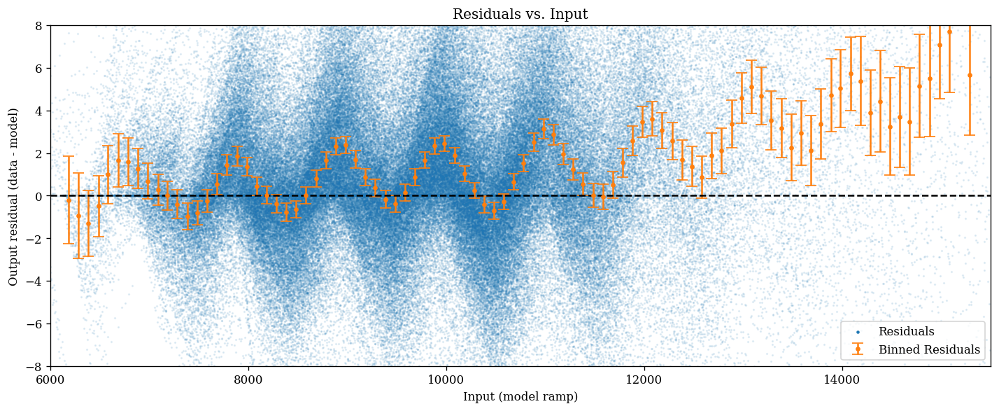

In [12]:
errplot = lambda x, y, yerr, **kwargs: plt.errorbar(
    x, y, yerr, marker="o", markersize=3, capsize=5, linestyle="None", **kwargs
)

plt.figure(figsize=(12, 5))
plt.title("Residuals vs. Input")
plt.xlabel("Input (model ramp)")
plt.ylabel("Output residual (data - model)")

plt.scatter(predicted_inputs, residuals, s=1, alpha=0.1)
plt.scatter([], [], s=3, label="Residuals", c="C0")
errplot(
    predicted_inputs_binned, residuals_binned, std_err_binned, label="Binned Residuals", c="C1"
)
plt.legend()

plt.axhline(0, color="k", linestyle="--")
plt.xlim(6000, 15500)
plt.ylim(-8, 8)

plt.tight_layout()
plt.show()

## Apply a simple correction

In [13]:
# Worlds dumbest fit: Fixed period of 1024 with a roughly hand tuned amplitude
period = 1024
sine_correction = 1.5 * np.sin((2 * np.pi * predicted_inputs) / period)
predicted_inputs_fix = predicted_inputs + sine_correction
residuals_fix = residuals + sine_correction

# Get the binned fixed values
sine_correction_binned = nan_bin(mean_fn(sine_correction))
residuals_fix_binned = nan_bin(mean_fn(residuals_fix))
std_err_fix_binned = nan_bin(sem_fn(measured_outputs))

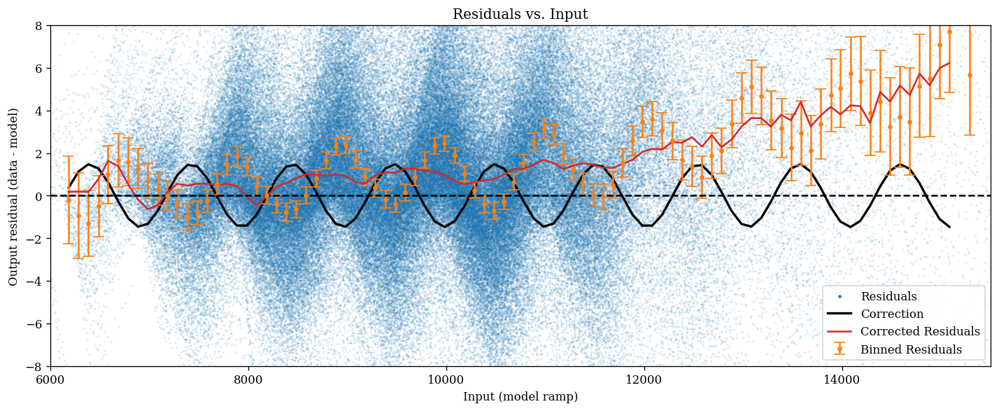

In [14]:
plt.figure(figsize=(12, 5))
plt.title("Residuals vs. Input")
plt.xlabel("Input (model ramp)")
plt.ylabel("Output residual (data - model)")

plt.scatter(predicted_inputs, residuals, s=1, alpha=0.1)
plt.scatter([], [], s=3, label="Residuals", c='C0')
plt.plot(
    predicted_inputs_binned,
    sine_correction_binned,
    linewidth=2,
    label="Correction",
    c="k",
)
errplot(
    predicted_inputs_binned,
    residuals_binned,
    std_err_fix_binned,
    label="Binned Residuals",
    c="C1",
)
plt.plot(
    predicted_inputs_binned, residuals_fix_binned, label="Corrected Residuals", c="C3"
)
plt.legend()

plt.axhline(0, color="k", linestyle="--")
plt.xlim(6000, 15500)
plt.ylim(-8, 8)

plt.tight_layout()
plt.show()

## Inject signal into model and examine residuals


In [16]:
# Worlds dumbest fit: Fixed period of 1024 with a roughly hand tuned amplitude
period = 1024
sine_fn = lambda x: 1.5 * np.sin((2 * np.pi * x) / period)
model_ramps_correction = jtu.tree_map(sine_fn, model_ramps)
model_ramps_fix = jtu.tree_map(lambda a, b: a + b, model_ramps, model_ramps_correction)

# Slopes, fixed slopes, and errors
slope_fn = lambda x: np.diff(x, axis=0)
model_slopes = jtu.tree_map(slope_fn, model_ramps)
model_slopes_fix = jtu.tree_map(slope_fn, model_ramps_fix)
data_slopes = dict([(key_fn(f), load_fn(f)) for f in files if "slope.npy" in f])
data_slope_errs = dict([(key_fn(f), load_fn(f)) for f in files if "slope_err.npy" in f])

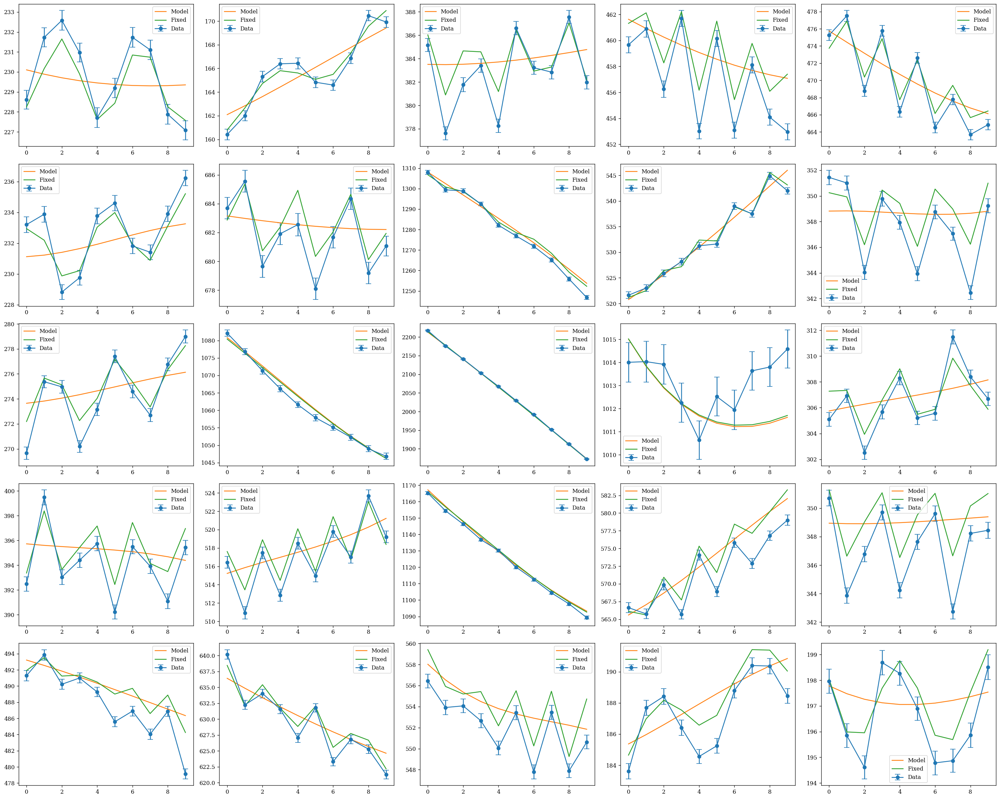

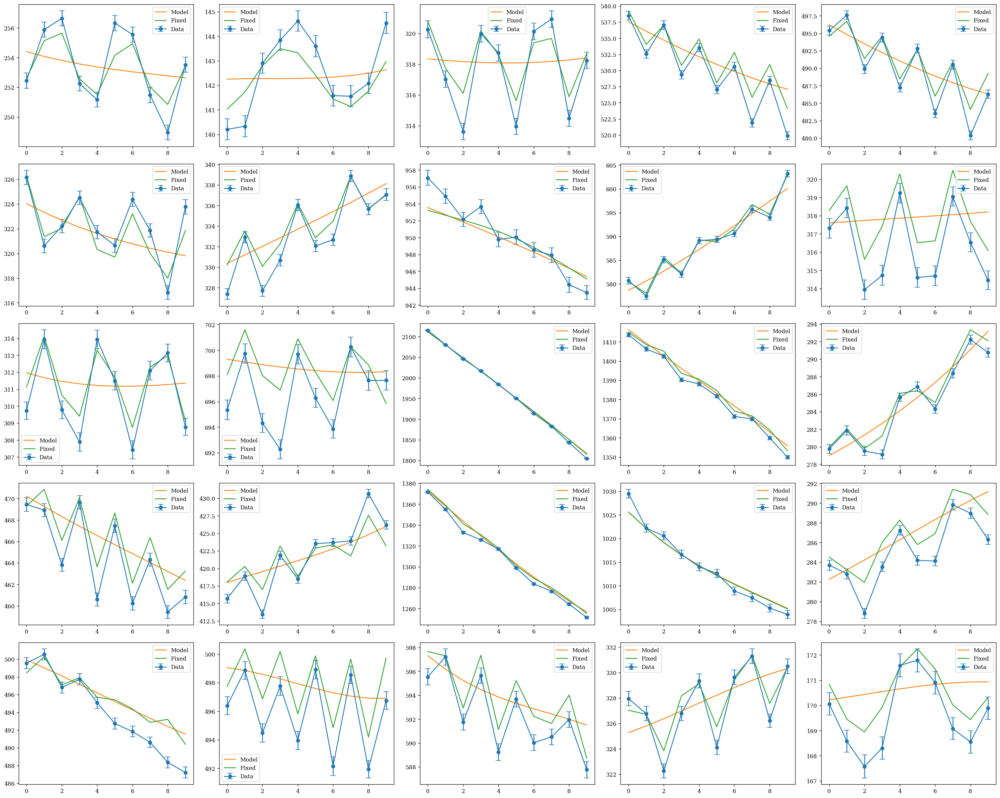

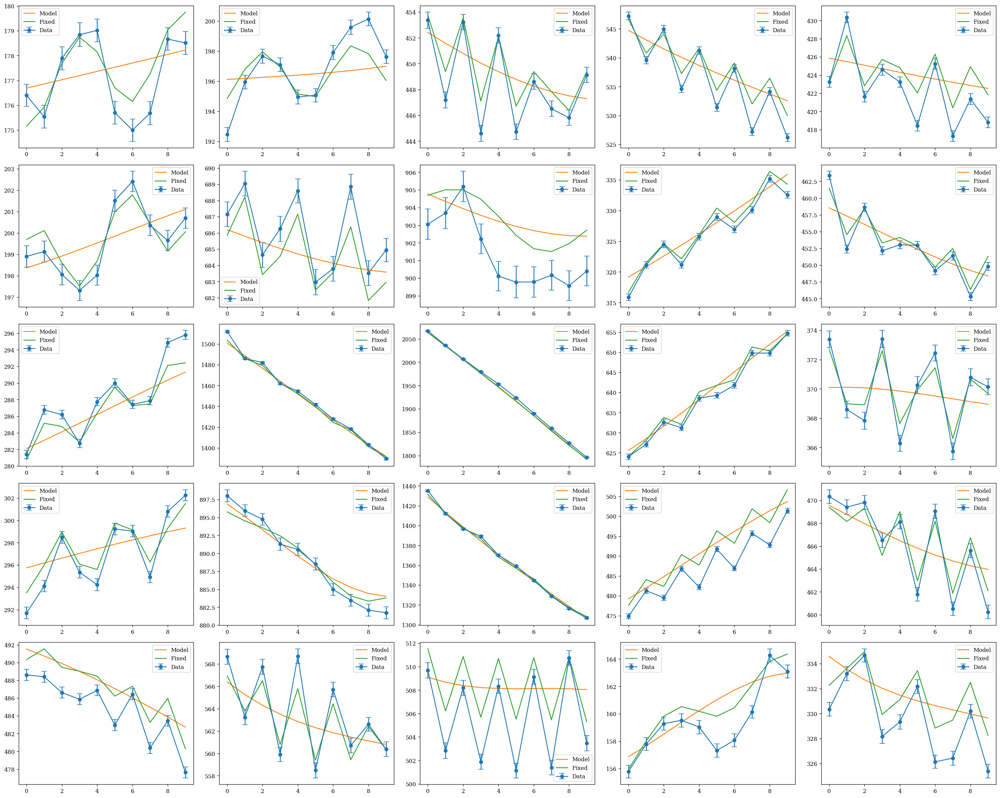

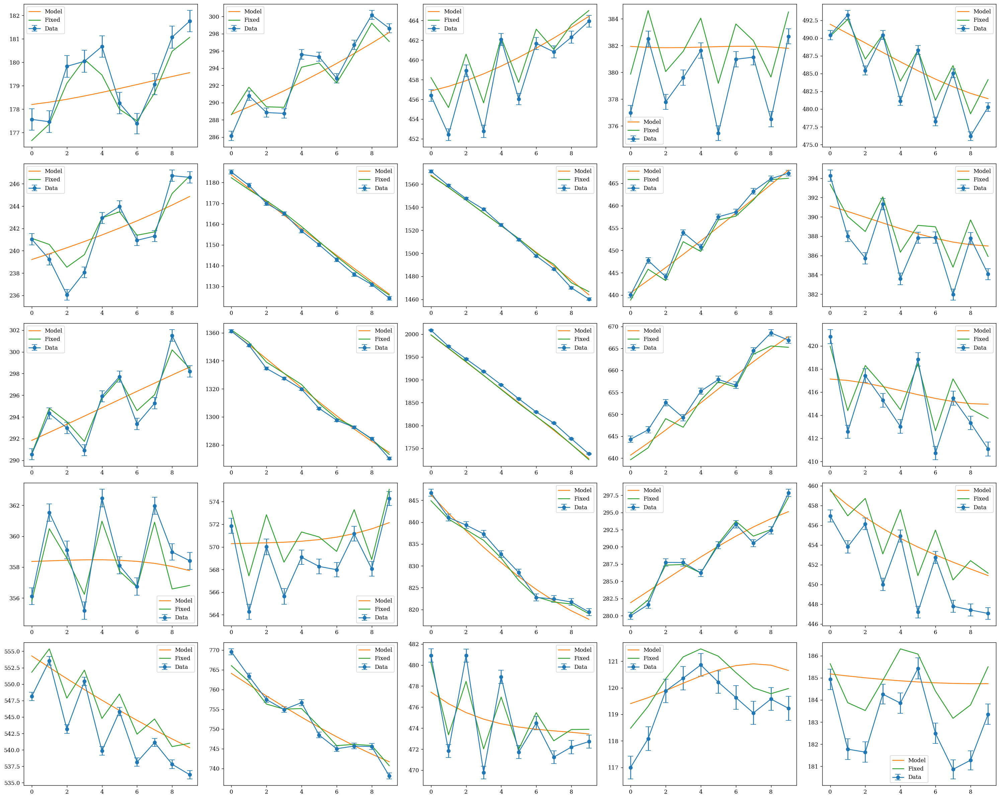

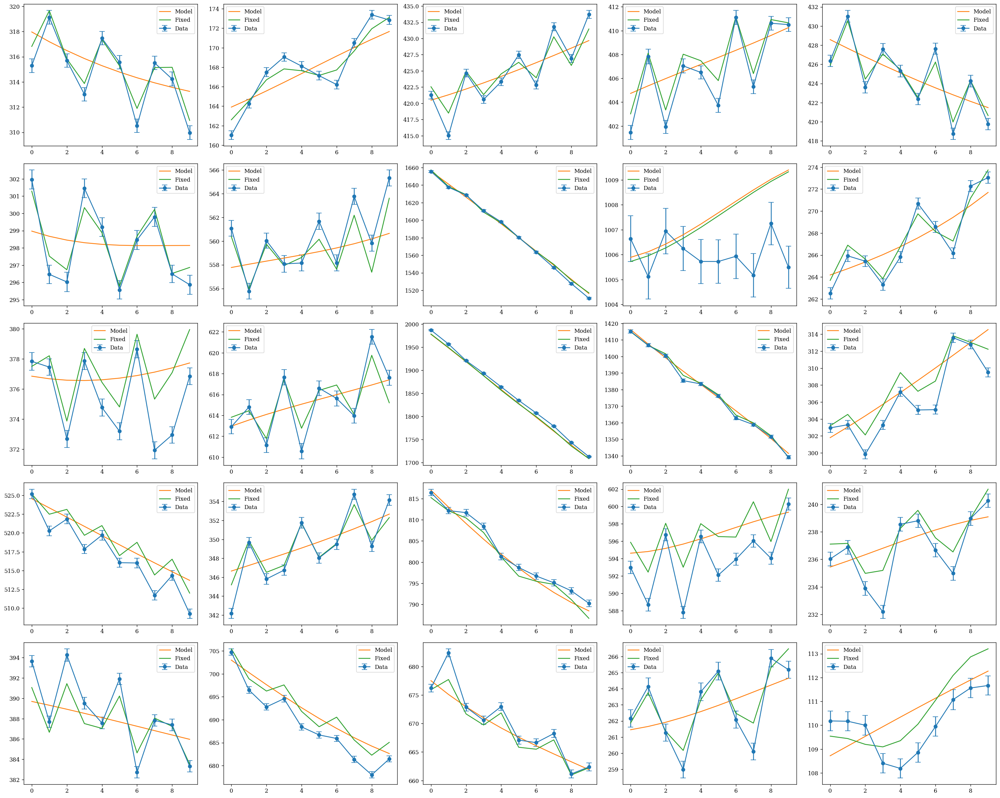

...

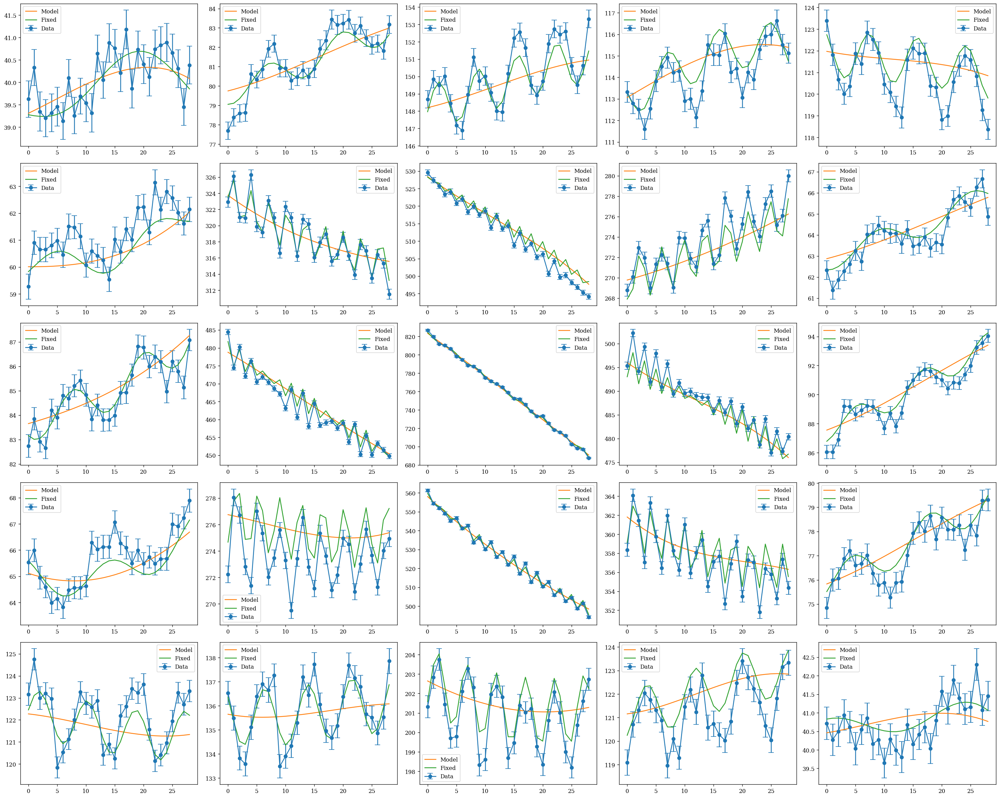

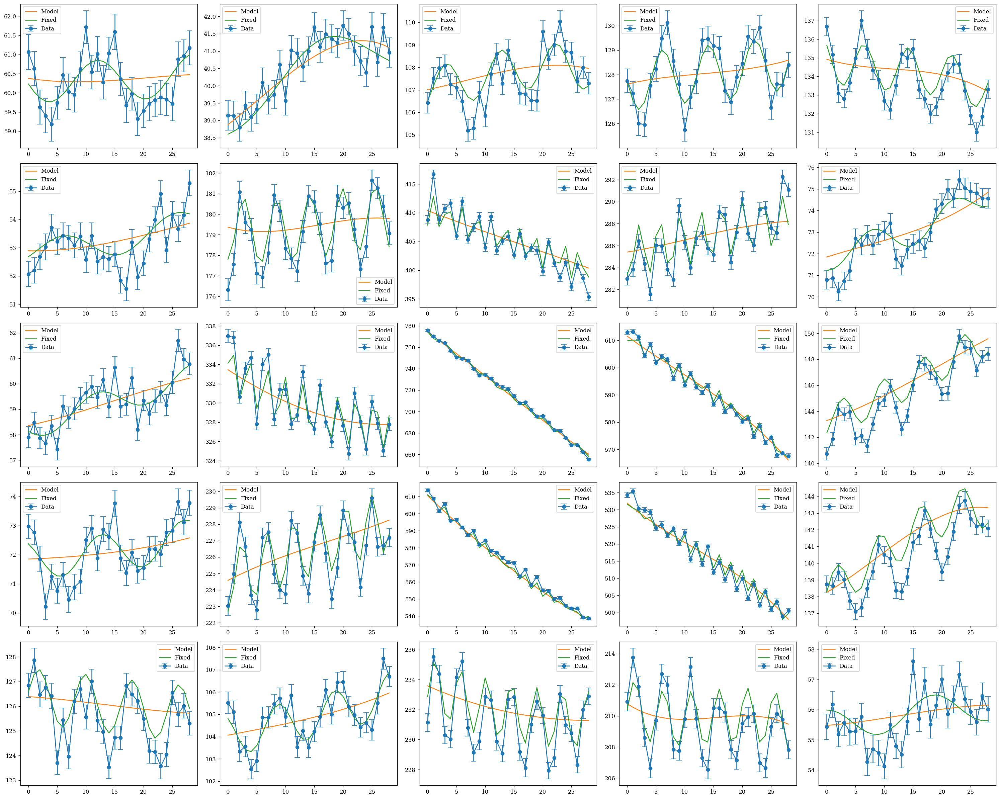

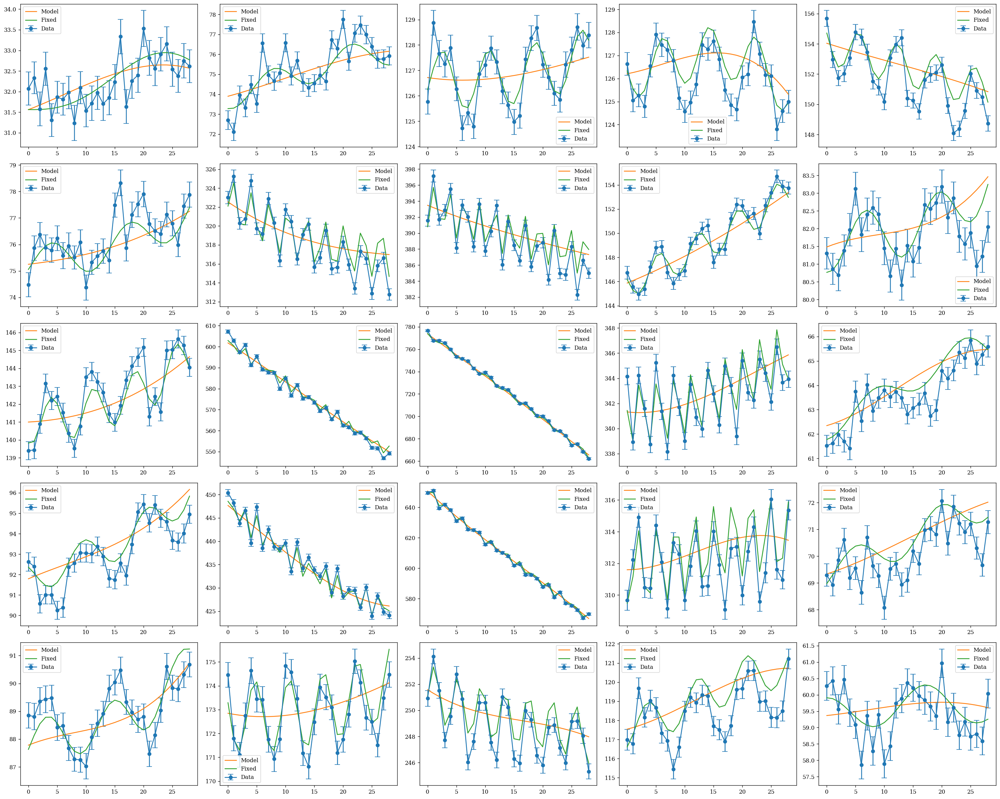

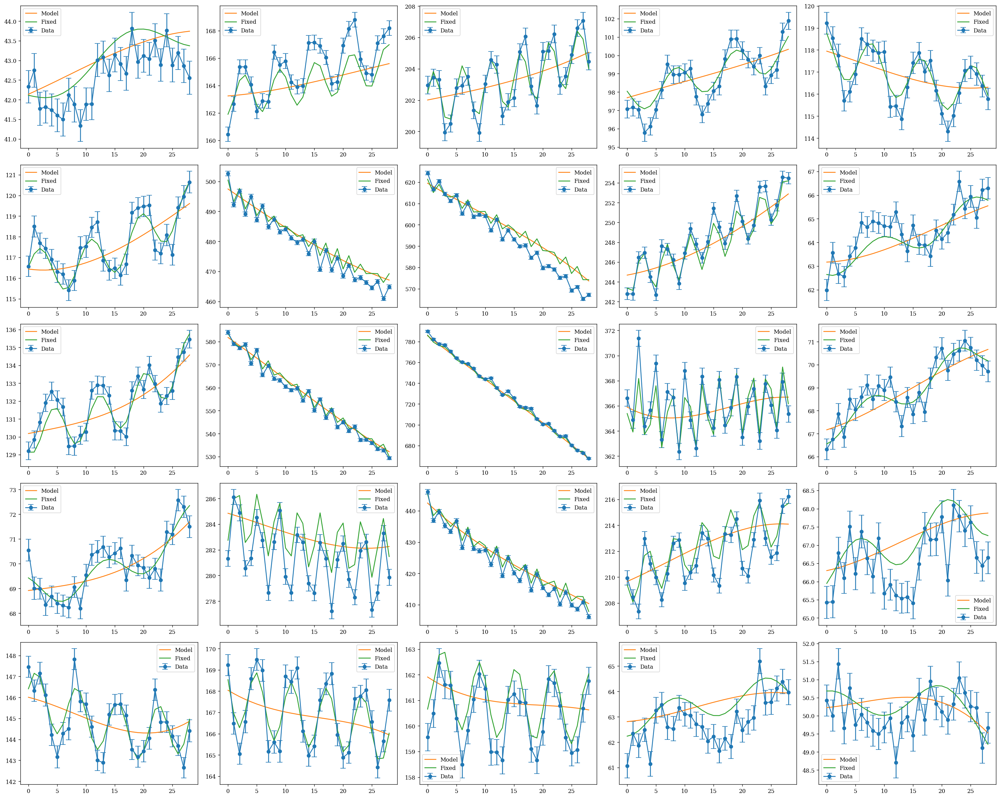

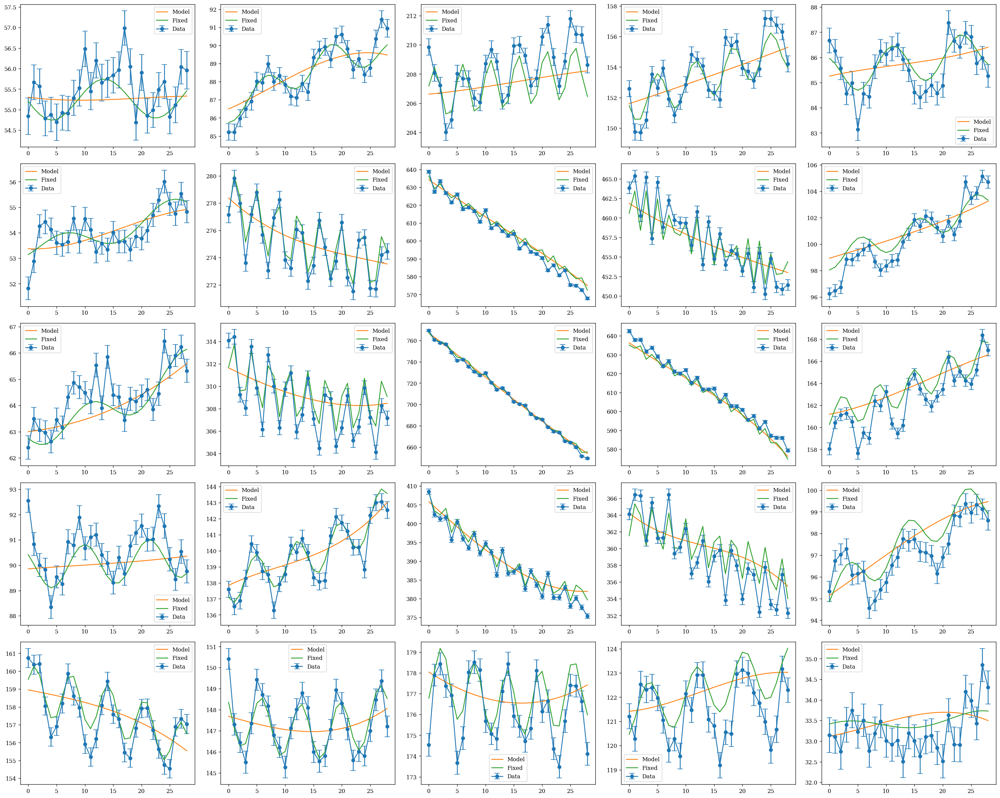

In [17]:
def convert_adjacent_to_true(bool_array, n=1, corners=False):
    for i in range(n):
        trues = np.array(np.where(bool_array))
        trues = np.swapaxes(trues, 0, 1)
        for i in range(len(trues)):
            y, x = trues[i]
            bool_array = bool_array.at[y, x + 1].set(True)
            bool_array = bool_array.at[y, x - 1].set(True)
            bool_array = bool_array.at[y + 1, x].set(True)
            bool_array = bool_array.at[y - 1, x].set(True)
            if corners:
                bool_array = bool_array.at[y + 1, x + 1].set(True)
                bool_array = bool_array.at[y - 1, x - 1].set(True)
                bool_array = bool_array.at[y + 1, x - 1].set(True)
                bool_array = bool_array.at[y - 1, x + 1].set(True)
    return bool_array

n = 2
k = 2 * n + 1

for key in list(model_slopes.keys()):
    # Number of radial pixels to plot
    data_slope = data_slopes[key]
    model_slope = model_slopes[key]
    fixed_slope = model_slopes_fix[key]
    err_slope = data_slope_errs[key]

    # Get the peak of the slopes
    im = data_slope.sum(0)
    peak_map = im == np.nanmax(im)
    peak_map = convert_adjacent_to_true(peak_map, corners=True, n=n)

    # Cut out the central bits
    ind = np.where(peak_map)
    small_data_slope = data_slope[:, *ind].reshape(-1, k, k)
    small_model_slope = model_slope[:, *ind].reshape(-1, k, k)
    small_fixed_slope = fixed_slope[:, *ind].reshape(-1, k, k)
    small_data_err = err_slope[:, *ind].reshape(-1, k, k)
    xs = np.arange(len(small_data_slope))

    # Plot
    plt.figure(figsize=(5 * k, 4 * k))
    for i in range(k):
        for j in range(k):
            plt.subplot(k, k, i * k + j + 1)
            plt.errorbar(
                xs, small_data_slope[:, i, j], yerr=small_data_err[:, i, j], marker='o', capsize=5, label='Data'
            )
            plt.plot(xs, small_model_slope[:, i, j], label="Model")
            plt.plot(xs, small_fixed_slope[:, i, j], label="Fixed")
            plt.legend()

    plt.tight_layout()
    plt.savefig(f"figs/sine_corrected_{key}")
    plt.show()